In [68]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy import optimize
import time
import os
import seaborn as sns
from classes import moments, parameters, var, history
from solver_funcs import calibration_func, fixed_point_solver, compute_deriv_welfare_to_patent_protec_US, compute_deriv_growth_to_patent_protec_US
from data_funcs import write_calibration_results
from functools import reduce
from tqdm import tqdm
from sankeyflow import Sankey
from bokeh.palettes import Category10, Dark2
import matplotlib.colors as mcolors
from copy import deepcopy
Category20 = Category10[10]+Dark2[8]

#%% define baseline and conditions of sensitivity analysis

baseline = '1020'
baseline_path = 'calibration_results_matched_economy/'+baseline+'/'
p_baseline = parameters()
p_baseline.load_run(baseline_path)
m_baseline = moments()
m_baseline.load_run(baseline_path)
sol, sol_baseline = fixed_point_solver(p_baseline,x0=p_baseline.guess,
                                        context='calibration',
                        cobweb_anim=False,tol =1e-14,
                        accelerate=False,
                        accelerate_when_stable=True,
                        cobweb_qty='phi',
                        plot_convergence=False,
                        plot_cobweb=False,
                        safe_convergence=0.001,
                        disp_summary=False,
                        damping = 10,
                        max_count = 5e4,
                        accel_memory = 50, 
                        accel_type1=True, 
                        accel_regularization=1e-10,
                        accel_relaxation=0.5, 
                        accel_safeguard_factor=1, 
                        accel_max_weight_norm=1e6,
                        damping_post_acceleration=5
                        )

sol_baseline = var.var_from_vector(sol.x, p_baseline,context = 'calibration')    
sol_baseline.scale_P(p_baseline)
# sol_baseline.compute_price_indices(p_baseline)
sol_baseline.compute_non_solver_quantities(p_baseline) 

m_baseline.compute_moments(sol_baseline, p_baseline)

table_path = f'calibration_results_matched_economy/baseline_{baseline}_sensitivity_tables/'

df = pd.read_csv(table_path+'all_sensitivity_table_20.csv',index_col=0)
df_with_signs = df.copy()
df = df.abs()

temp = {}

for mom in ['RD_','RP_','SRGDP_','SPFLOW_origin_','SPFLOW_destination_']:
    temp[mom+'sum'] = df.loc[[mom+c for c in p_baseline.countries]].sum(axis=0)
    df.loc[mom+'sum'] = temp[mom+'sum']
for param in ['delta ','eta ','T Patent ','T Non patent ']:
    temp[param+'sum'] = df[[param+c for c in p_baseline.countries]].sum(axis=1)
    df[param+'sum'] = temp[param+'sum']
    
temp = {}

for mom in ['RD_','RP_','SRGDP_','SPFLOW_origin_','SPFLOW_destination_']:
    temp[mom+'sum'] = df_with_signs.loc[[mom+c for c in p_baseline.countries]].sum(axis=0)
    df_with_signs.loc[mom+'sum'] = temp[mom+'sum']
for param in ['delta ','eta ','T Patent ','T Non patent ']:
    temp[param+'sum'] = df_with_signs[[param+c for c in p_baseline.countries]].sum(axis=1)
    df_with_signs[param+'sum'] = temp[param+'sum']
    
#for mom in ['RD_','RP_','SRGDP_','SPFLOW_origin_','SPFLOW_destination_']:
#    df.loc[mom+'sum'] = temp[mom+'sum']
#for param in ['delta ','eta ','T Patent ','T Non patent ']:
#    df[param+'sum'] = temp[param+'sum']
    
df = df.drop(['RD_'+c for c in ['CHN','IND','BRA','RUS','ROW','MEX']])
df_with_signs = df_with_signs.drop(['RD_'+c for c in ['CHN','IND','BRA','RUS','ROW','MEX']])

def remove_idx_and_col_that_end_with(df,end):
    df_temp = df.copy()
    df_temp = df_temp.loc[[i for i in df_temp.index if not i.endswith(end)]]
    df_temp = df_temp[[i for i in df_temp.columns if not i.endswith(end)]]
    return df_temp

#palette = sns.color_palette("hls", 20).as_hex()
palette = list(sns.color_palette().as_hex())+list(Dark2[8])+list(sns.color_palette().as_hex())+list(Dark2[8])

flow_color_mode_alpha = 0.8

def conv_color(color,alpha=1):
    color = mcolors.to_rgba(color)
    color = (*color[:3], color[3] * flow_color_mode_alpha)
    return color

c = 0
colors = {}
for country in p_baseline.countries:
    country_color = conv_color(palette[c],0.9)
    for mom in ['RD_','RP_','SRGDP_','SPFLOW_origin_','SPFLOW_destination_']:
        colors[mom+country] = country_color
    for param in ['delta ','eta ','T Patent ','T Non patent ']:
        colors[param+country] = country_color
    #colors['RP_'+country] = country_color
    #colors['SRGDP_'+country] = country_color
    #colors['SPFLOW_destination_'+country] = country_color
    #colors['SPFLOW_origin_'+country] = country_color
    #colors['delta '+country] = country_color
    #colors['eta '+country] = country_color
    #colors['T Patent '+country] = country_color
    #colors['T Non patent '+country] = country_color
    c = c+1
count = c
for mom in ['UUPCOST','GROWTH','GPDIFF','KM','TE','TO','OUT','DOMPATINUS','SINNOVPATUS']+[mom+'sum' for mom in ['RD_','RP_','SRGDP_','SPFLOW_origin_','SPFLOW_destination_']]:
    colors[mom] = conv_color(palette[c],0.8)
    c = c+1
for par in ['theta','k','g_0','fe','fo','zeta','nu']+[par+'sum' for par in ['delta ','eta ','T Patent ','T Non patent ']]:
    colors[par] = conv_color(sns.color_palette().as_hex()[7],0.9)
    #colors[par] = (*colors[par][:3], colors[par][3] * flow_color_mode_alpha)


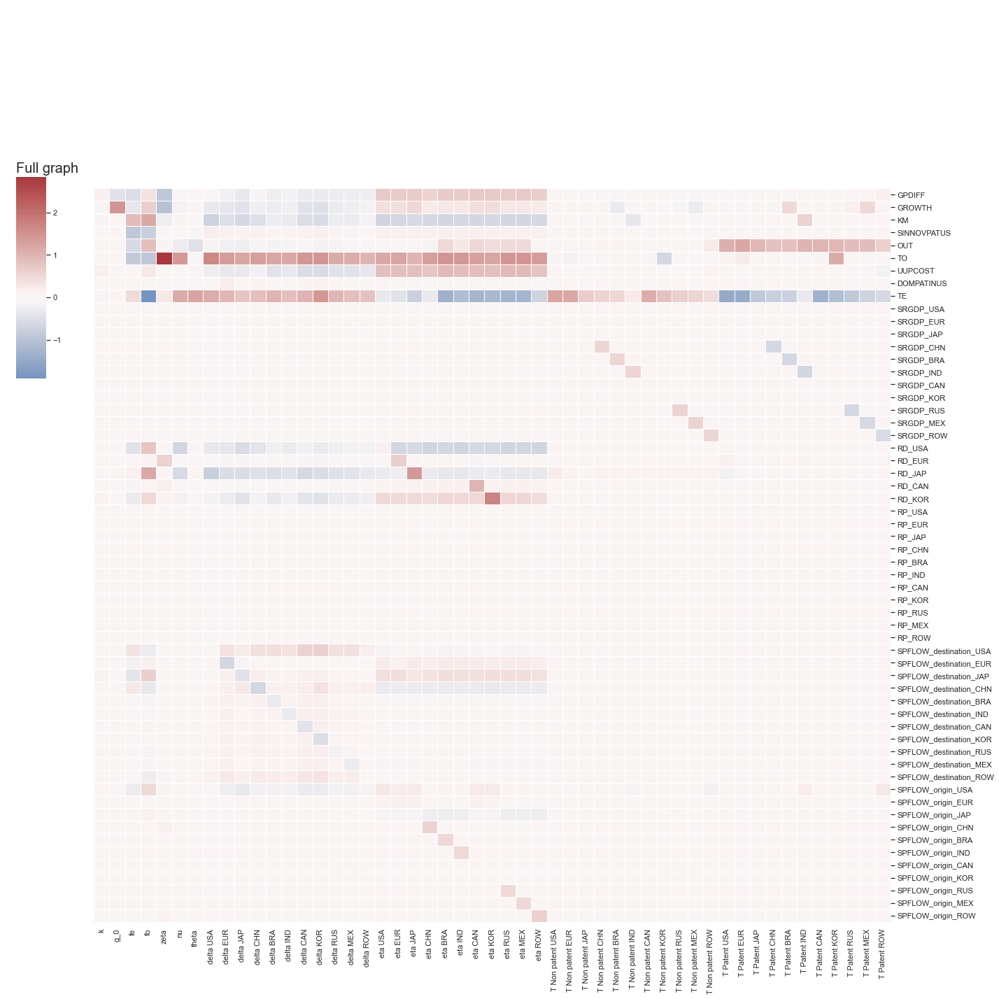

In [69]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df_with_signs.copy()
df_temp = remove_idx_and_col_that_end_with(df_temp,'sum')

sns.clustermap(df_temp,dendrogram_ratio=(.1, .2),figsize=(20, 20),
                   cbar_pos=(.02, 0.62, .03, .2),
                   linewidths=.75,cmap="vlag",row_cluster=False, col_cluster=False,center=0)

plt.title('Full graph',loc='left',fontsize = 20)
plt.show()

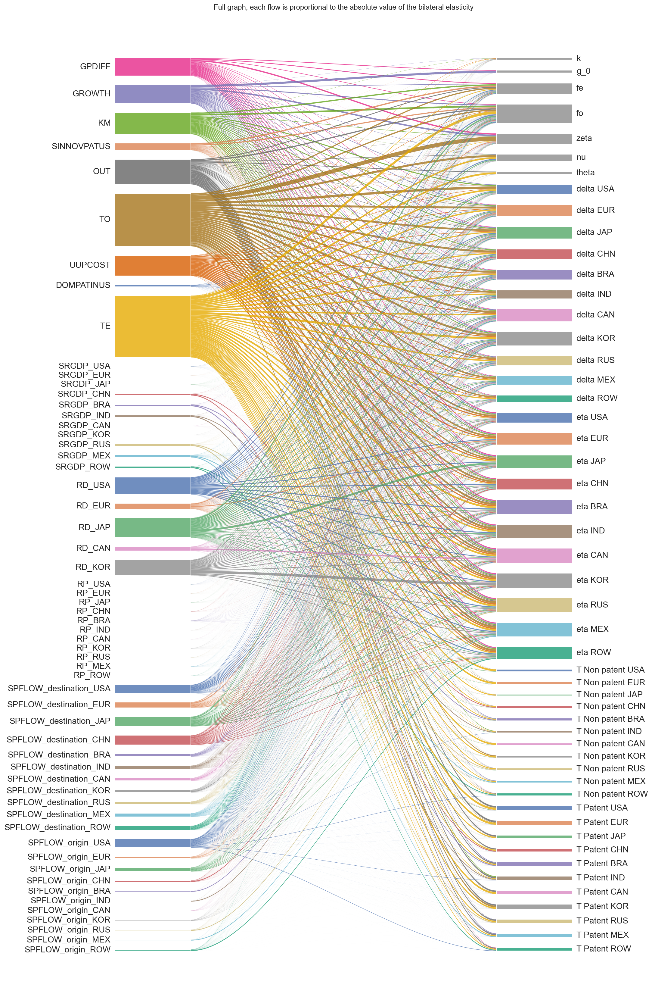

In [65]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df.copy()
df_temp = remove_idx_and_col_that_end_with(df_temp,'sum')

plt.figure(figsize=(15, 30), dpi=144)

for count,mom in enumerate(df_temp.index):
    for param in df_temp.columns:
        flows.append([mom,param,np.abs(df_temp.loc[mom,param])])

nodes = [nodes_mom, nodes_params]

#flow_color_mode_alpha = 0.8

s = Sankey(
    flows=flows,
    flow_color_mode='source',
    nodes=None,
    #node_opts={'label_opts':dict(fontsize=8)}
)
for node in s.nodes[1]:
    node.label_pos = 'right'
    node.width = 0.2
    node.color = colors[node.name]
for node in s.nodes[0]:
    node.width = 0.2
    node.color = colors[node.name]
for flow in s.flows:
    #color = mcolors.to_rgba(colors[flow.src.name])
    #color = (*color[:3], color[3] * flow_color_mode_alpha)
    flow.color = colors[flow.src.name]
s.draw()
plt.title('Full graph, each flow is proportional to the absolute value of the bilateral elasticity')
plt.show()

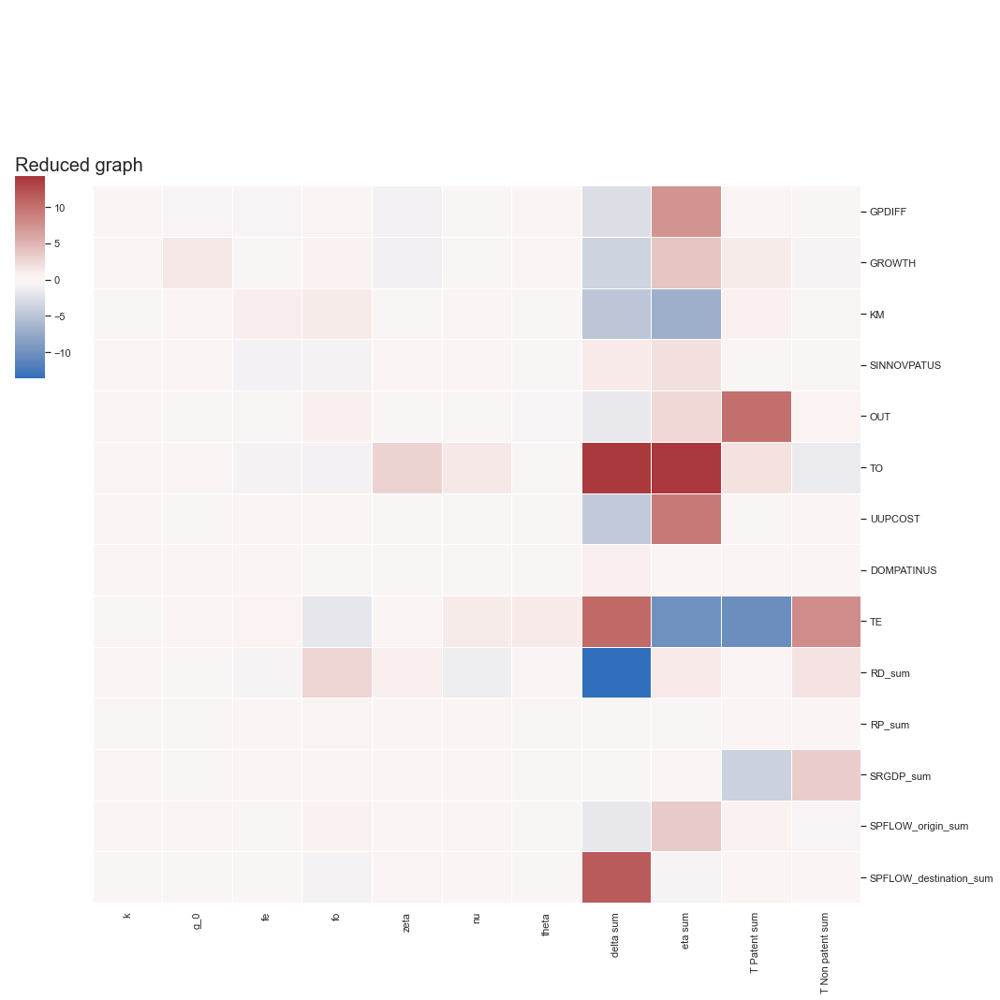

In [71]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df_with_signs.copy()
for country in p_baseline.countries:
    df_temp = remove_idx_and_col_that_end_with(df_temp,country)

sns.clustermap(df_temp,dendrogram_ratio=(.1, .2),figsize=(15, 15),
                   cbar_pos=(.02, 0.62, .03, .2),
                   linewidths=.75,cmap="vlag",row_cluster=False, col_cluster=False,center=0)

plt.title('Reduced graph',loc='left',fontsize = 20)
plt.show()

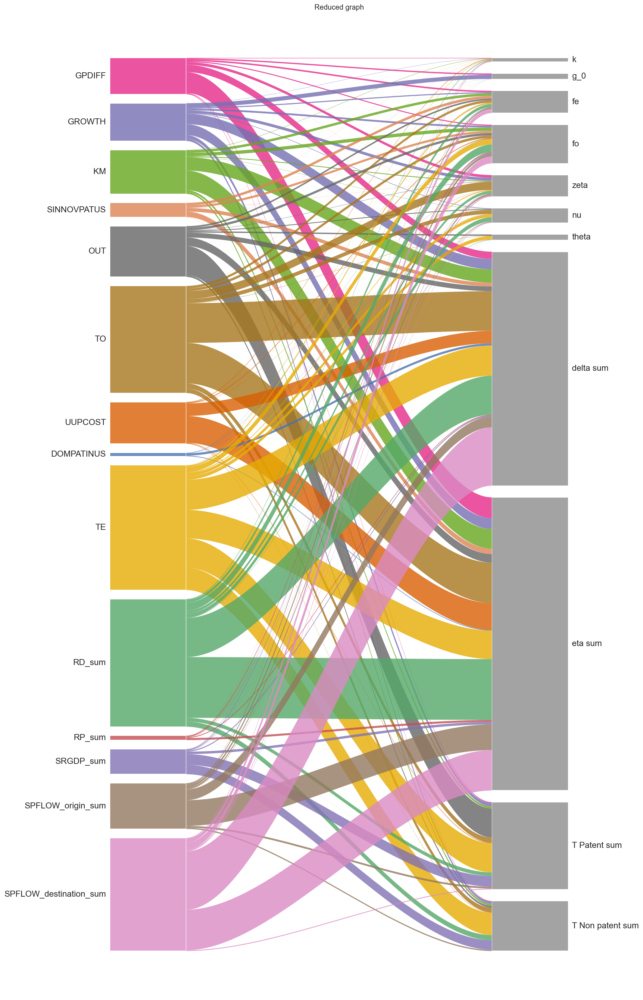

In [72]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df.copy()
for country in p_baseline.countries:
    df_temp = remove_idx_and_col_that_end_with(df_temp,country)

plt.figure(figsize=(15, 30), dpi=144)

for count,mom in enumerate(df_temp.index):
    for param in df_temp.columns:
        flows.append([mom,param,np.abs(df_temp.loc[mom,param])])

nodes = [nodes_mom, nodes_params]

#flow_color_mode_alpha = 0.8

s = Sankey(
    flows=flows,
    flow_color_mode='source',
    nodes=None,
    #node_opts={'label_opts':dict(fontsize=8)}
)
for node in s.nodes[1]:
    node.label_pos = 'right'
    node.width = 0.2
    node.color = colors[node.name]
for node in s.nodes[0]:
    node.width = 0.2
    node.color = colors[node.name]
for flow in s.flows:
    #color = mcolors.to_rgba(colors[flow.src.name])
    #color = (*color[:3], color[3] * flow_color_mode_alpha)
    flow.color = colors[flow.src.name]
s.draw()
plt.title('Reduced graph')
plt.show()

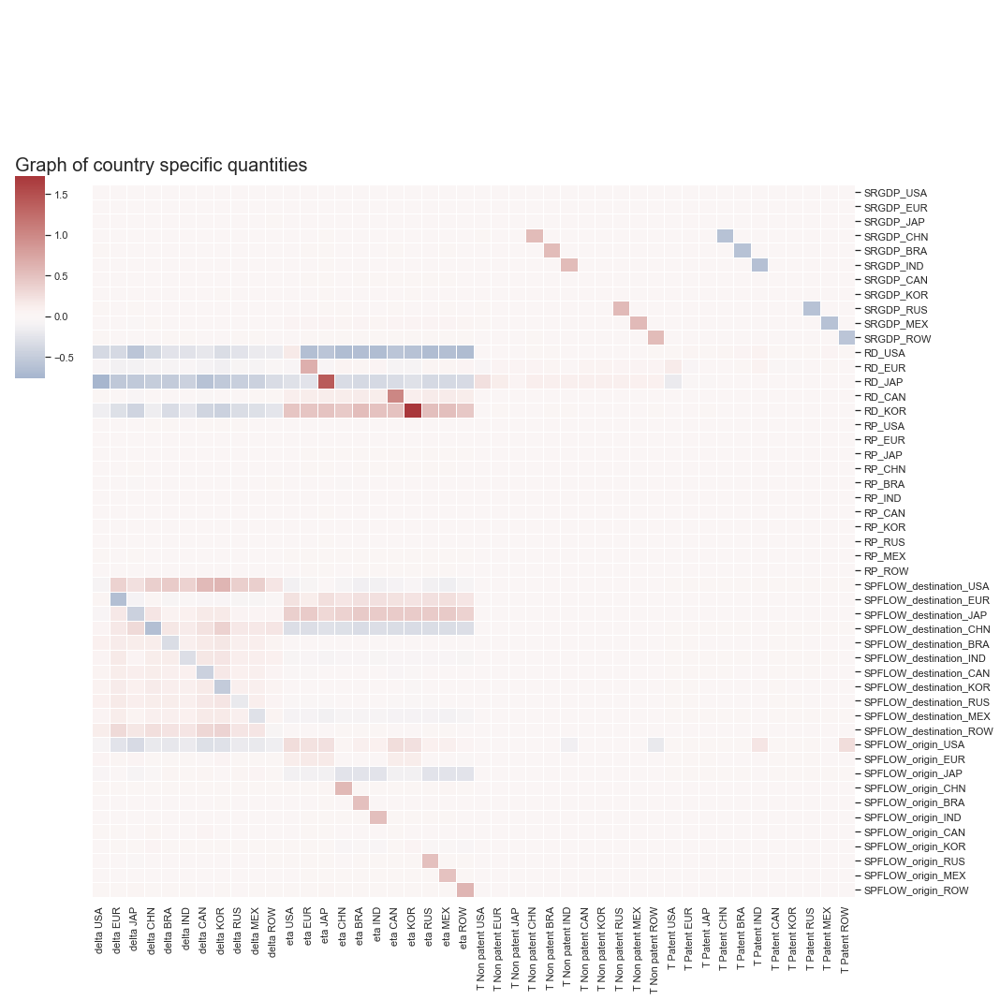

In [73]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df_with_signs.copy()
df_temp = df_temp.loc[[i for i in df_temp.index if i[-3:] in p_baseline.countries]]
df_temp = df_temp[[i for i in df_temp.columns if i[-3:] in p_baseline.countries]]

sns.clustermap(df_temp,dendrogram_ratio=(.1, .2),figsize=(15, 15),
                   cbar_pos=(.02, 0.62, .03, .2),
                   linewidths=.75,cmap="vlag",row_cluster=False, col_cluster=False,center=0)

plt.title('Graph of country specific quantities',loc='left',fontsize = 20)
plt.show()

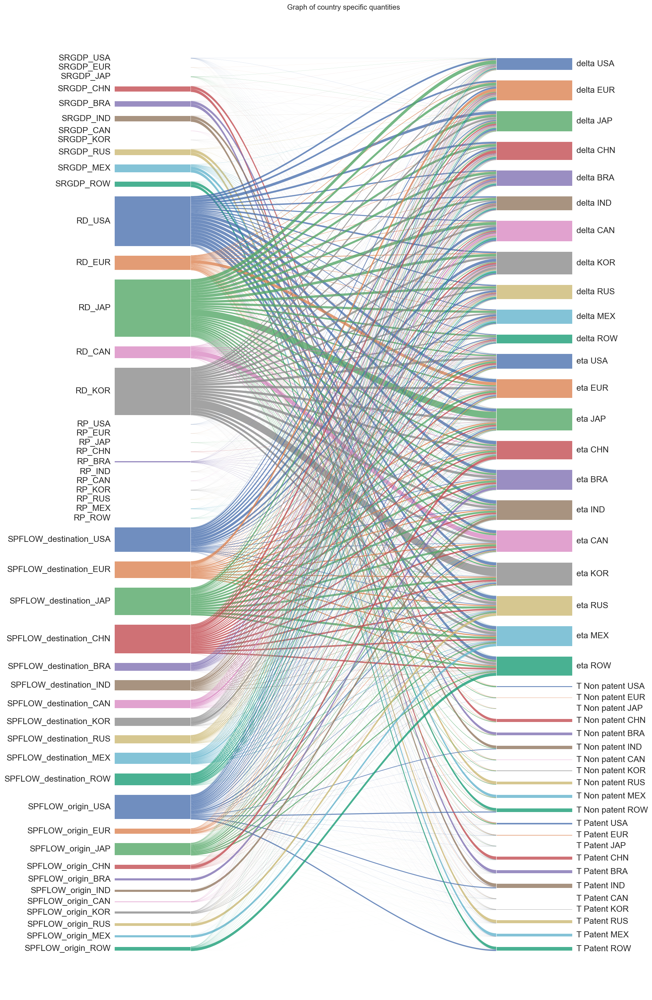

In [74]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df.copy()
df_temp = df_temp.loc[[i for i in df_temp.index if i[-3:] in p_baseline.countries]]
df_temp = df_temp[[i for i in df_temp.columns if i[-3:] in p_baseline.countries]]

plt.figure(figsize=(15, 30), dpi=144)

for count,mom in enumerate(df_temp.index):
    for param in df_temp.columns:
        flows.append([mom,param,np.abs(df_temp.loc[mom,param])])

nodes = [nodes_mom, nodes_params]

#flow_color_mode_alpha = 0.8

s = Sankey(
    flows=flows,
    flow_color_mode='source',
    nodes=None,
    #node_opts={'label_opts':dict(fontsize=8)}
)
for node in s.nodes[1]:
    node.label_pos = 'right'
    node.width = 0.2
    node.color = colors[node.name]
for node in s.nodes[0]:
    node.width = 0.2
    node.color = colors[node.name]
for flow in s.flows:
    #color = mcolors.to_rgba(colors[flow.src.name])
    #color = (*color[:3], color[3] * flow_color_mode_alpha)
    flow.color = colors[flow.src.name]
s.draw()
plt.title('Graph of country specific quantities')
plt.show()

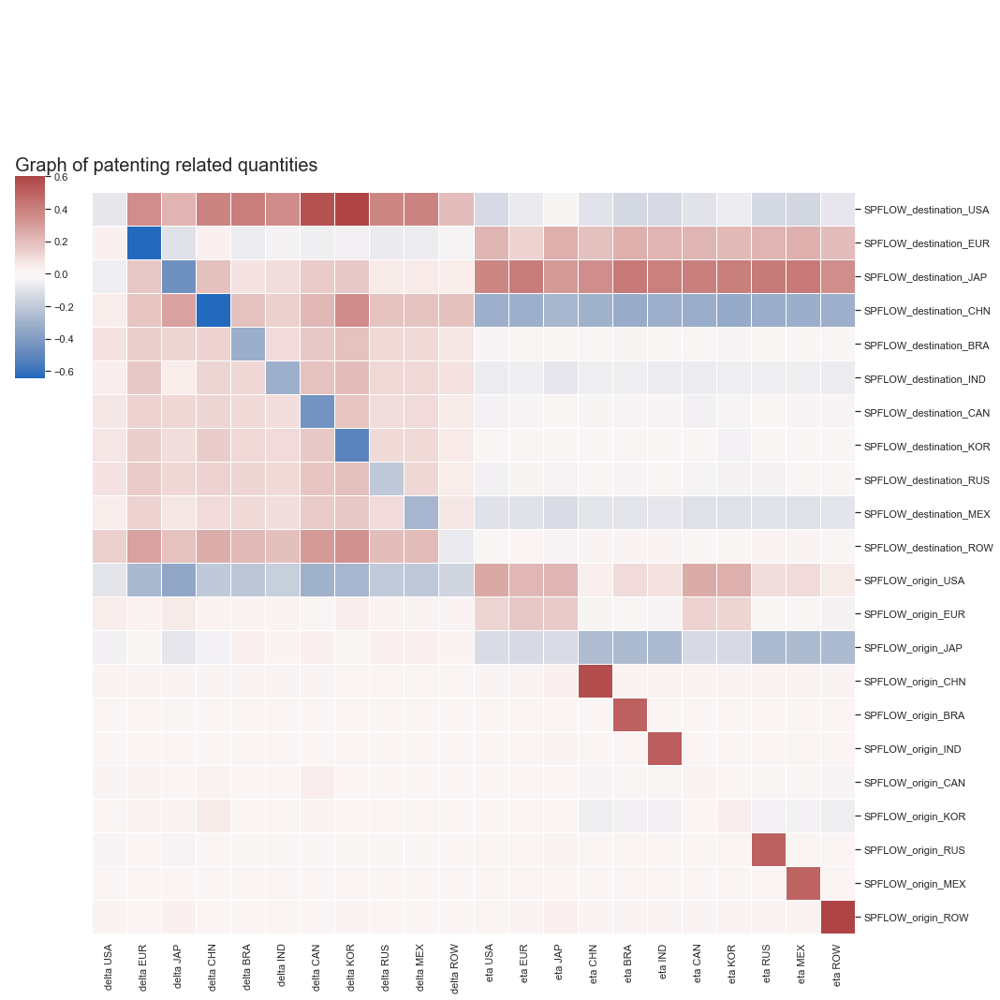

In [75]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df_with_signs.copy()
df_temp = df_temp.loc[[i for i in df_temp.index if any([i.startswith(mom) for mom in ['SPFLOW']])]]
df_temp = df_temp[[i for i in df_temp.columns if any([i.startswith(par) for par in ['delta','eta']])]]
df_temp = remove_idx_and_col_that_end_with(df_temp,'sum')

sns.clustermap(df_temp,dendrogram_ratio=(.1, .2),figsize=(15, 15),
                   cbar_pos=(.02, 0.62, .03, .2),
                   linewidths=.75,cmap="vlag",row_cluster=False, col_cluster=False,center=0)

plt.title('Graph of patenting related quantities',loc='left',fontsize = 20)
plt.show()

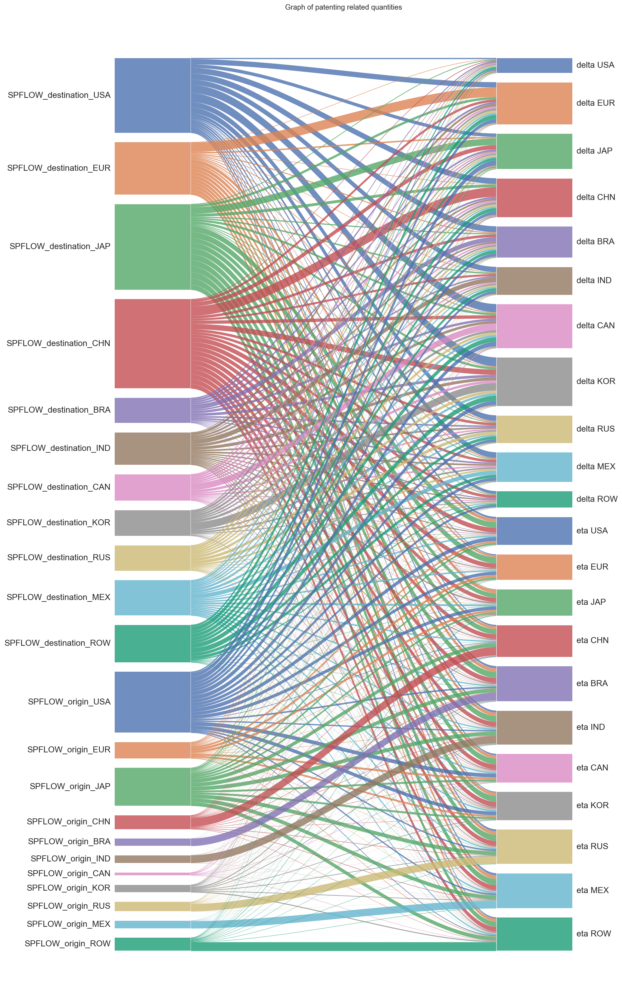

In [76]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df.copy()
df_temp = df_temp.loc[[i for i in df_temp.index if any([i.startswith(mom) for mom in ['SPFLOW']])]]
df_temp = df_temp[[i for i in df_temp.columns if any([i.startswith(par) for par in ['delta','eta']])]]
df_temp = remove_idx_and_col_that_end_with(df_temp,'sum')

plt.figure(figsize=(15, 30), dpi=144)

for count,mom in enumerate(df_temp.index):
    for param in df_temp.columns:
        flows.append([mom,param,np.abs(df_temp.loc[mom,param])])

nodes = [nodes_mom, nodes_params]

#flow_color_mode_alpha = 0.8

s = Sankey(
    flows=flows,
    flow_color_mode='source',
    nodes=None,
    #node_opts={'label_opts':dict(fontsize=8)}
)
for node in s.nodes[1]:
    node.label_pos = 'right'
    node.width = 0.2
    node.color = colors[node.name]
for node in s.nodes[0]:
    node.width = 0.2
    node.color = colors[node.name]
for flow in s.flows:
    #color = mcolors.to_rgba(colors[flow.src.name])
    #color = (*color[:3], color[3] * flow_color_mode_alpha)
    flow.color = colors[flow.src.name]
s.draw()
plt.title('Graph of patenting related quantities')
plt.show()

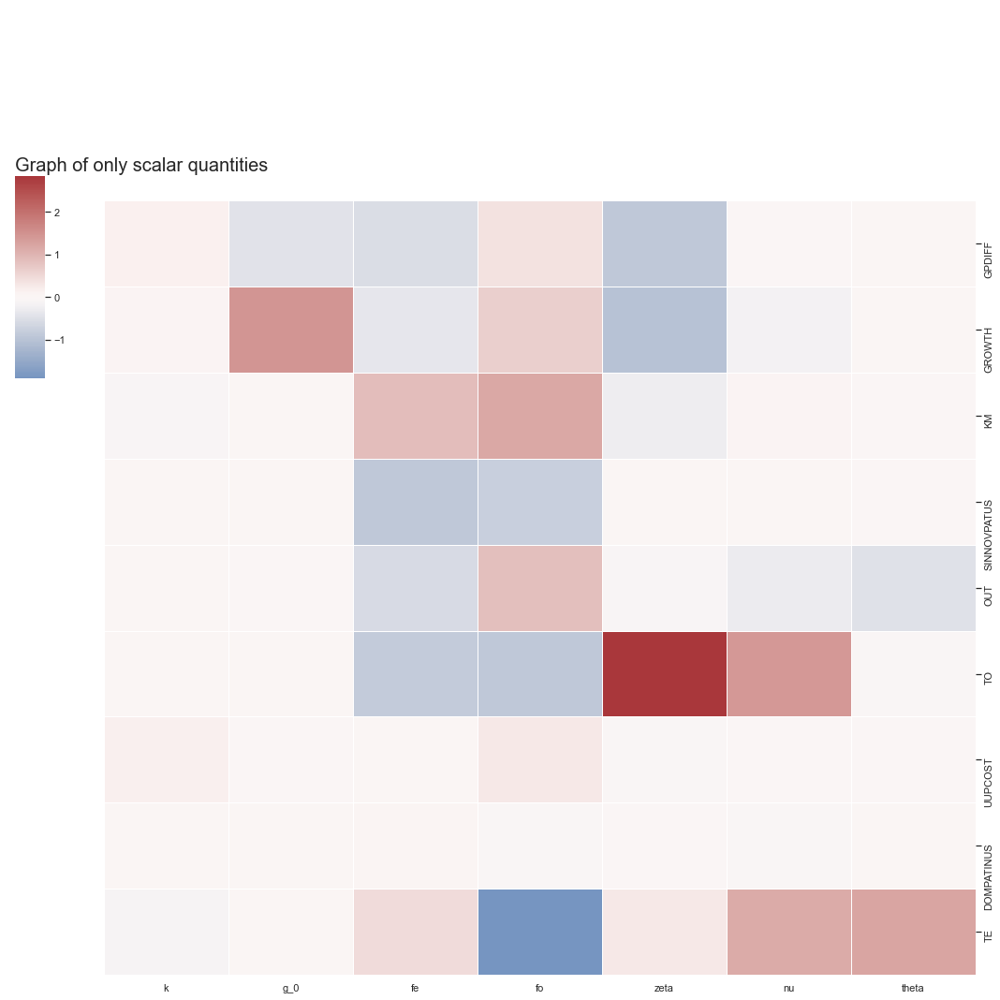

In [77]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df_with_signs.copy()
for country in p_baseline.countries:
    df_temp = remove_idx_and_col_that_end_with(df_temp,country)
df_temp = remove_idx_and_col_that_end_with(df_temp,'sum')


sns.clustermap(df_temp,dendrogram_ratio=(.1, .2),figsize=(15, 15),
                   cbar_pos=(.02, 0.62, .03, .2),
                   linewidths=.75,cmap="vlag",row_cluster=False, col_cluster=False,center=0)

plt.title('Graph of only scalar quantities',loc='left',fontsize = 20)
plt.show()

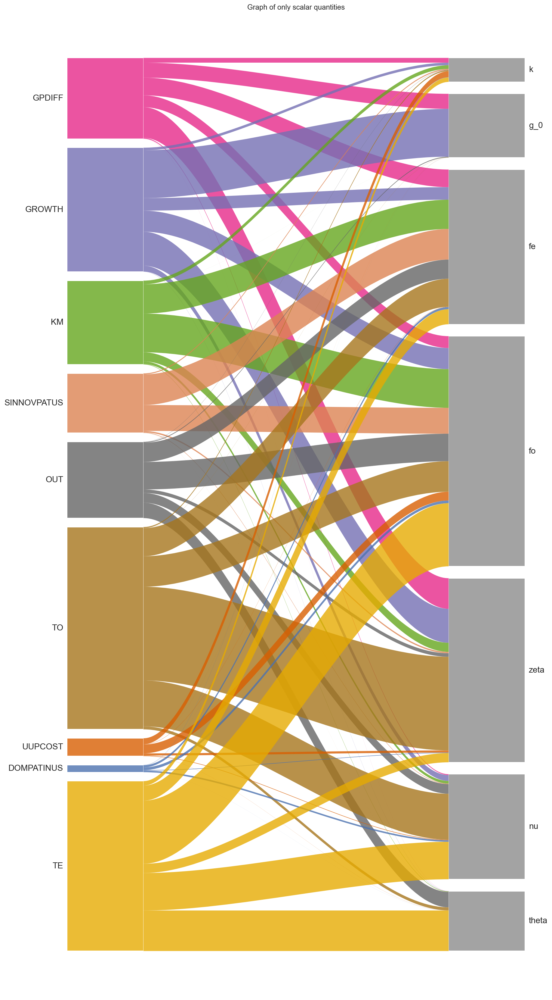

In [78]:
from sankeyflow import Sankey
nodes_mom = []
nodes_params = []
flows = []
df_temp = df.copy()
for country in p_baseline.countries:
    df_temp = remove_idx_and_col_that_end_with(df_temp,country)
df_temp = remove_idx_and_col_that_end_with(df_temp,'sum')

plt.figure(figsize=(15, 30), dpi=144)

for count,mom in enumerate(df_temp.index):
    for param in df_temp.columns:
        flows.append([mom,param,np.abs(df_temp.loc[mom,param])])

nodes = [nodes_mom, nodes_params]

#flow_color_mode_alpha = 0.8

s = Sankey(
    flows=flows,
    flow_color_mode='source',
    nodes=None,
    #node_opts={'label_opts':dict(fontsize=8)}
)
for node in s.nodes[1]:
    node.label_pos = 'right'
    node.width = 0.2
    node.color = colors[node.name]
for node in s.nodes[0]:
    node.width = 0.2
    node.color = colors[node.name]
for flow in s.flows:
    #color = mcolors.to_rgba(colors[flow.src.name])
    #color = (*color[:3], color[3] * flow_color_mode_alpha)
    flow.color = colors[flow.src.name]
s.draw()
plt.title('Graph of only scalar quantities')
plt.show()

In [ ]:
baseline = '1020'
baseline_path = 'calibration_results_matched_economy/'+baseline+'/'
p_baseline = parameters()
p_baseline.load_run(baseline_path)
m_baseline = moments()
m_baseline.load_run(baseline_path)
sol, sol_baseline = fixed_point_solver(p_baseline,x0=p_baseline.guess,
                                        context='calibration',
                        cobweb_anim=False,tol =1e-14,
                        accelerate=False,
                        accelerate_when_stable=True,
                        cobweb_qty='phi',
                        plot_convergence=False,
                        plot_cobweb=False,
                        safe_convergence=0.001,
                        disp_summary=False,
                        damping = 10,
                        max_count = 5e4,
                        accel_memory = 50, 
                        accel_type1=True, 
                        accel_regularization=1e-10,
                        accel_relaxation=0.5, 
                        accel_safeguard_factor=1, 
                        accel_max_weight_norm=1e6,
                        damping_post_acceleration=5
                        )

sol_baseline = var.var_from_vector(sol.x, p_baseline,context = 'calibration')    
sol_baseline.scale_P(p_baseline)
# sol_baseline.compute_price_indices(p_baseline)
sol_baseline.compute_non_solver_quantities(p_baseline) 

m_baseline.compute_moments(sol_baseline, p_baseline)

moments_to_change = ['GPDIFF', 'GROWTH', 'KM', 'OUT', 'RD', 'RP', 'SRGDP', 'SINNOVPATUS',
  'TO', 'SPFLOW', 'UUPCOST', 'DOMPATINUS', 'TE']
# moments_to_change = ['SPFLOW', 'UUPCOST', 'DOMPATINUS', 'TE']
parameters_to_change = ['gamma','rho','kappa']

weights_to_change = m_baseline.list_of_moments

dropbox_path = '/Users/slepot/Dropbox/TRIPS/simon_version/code/calibration_results_matched_economy/'

parent_moment_result_path = 'calibration_results_matched_economy/baseline_'+baseline+'_all_targets_variations_20/'

df = pd.DataFrame()

moments_to_change = ['GPDIFF', 'GROWTH', 'KM', 'SINNOVPATUS', 'OUT',
  'TO', 'UUPCOST', 'DOMPATINUS', 'TE', 'SRGDP', 'RD', 'RP', 'SPFLOW']
# moments_to_change = ['GPDIFF', 'GROWTH', 'KM', 'SINNOVPATUS',
#   'UUPCOST', 'DOMPATINUS', 'SRGDP', 'RD', 'RP', 'SPFLOW']
# moments_to_change = ['RD']


def fill_row(df,parent_moment_result_path,mom_idx,p_baseline):
    p = parameters()
    p.load_run(parent_moment_result_path+mom_idx+'/')
    df.loc[mom_idx,'k'] = (p.k/p_baseline.k-1)/0.20
    df.loc[mom_idx,'g_0'] = (p.g_0/p_baseline.g_0-1)/0.20
    for par in ['fe','fo','zeta','nu','theta']:
        df.loc[mom_idx,par] = (getattr(p,par)[1]/getattr(p_baseline,par)[1]-1)/0.20
    for par in ['delta','eta']:
        for c,country in enumerate(p_baseline.countries):
            df.loc[mom_idx,par+' '+country] = (getattr(p,par)[c,1]/getattr(p_baseline,par)[c,1]-1)/0.20
    for par in ['T']:
        for s,sector in enumerate(p_baseline.sectors):
            for c,country in enumerate(p_baseline.countries):
                df.loc[mom_idx,par+' '+sector+' '+country
                       ] = (getattr(p,par)[c,s]**(1/p.theta[s])
                            /getattr(p_baseline,par)[c,s]**(1/p_baseline.theta[s])-1)/0.20

for mom in moments_to_change:
    print(mom)
    if mom in ['KM','UUPCOST','SINNOVPATUS','TO','GROWTH',
                          'DOMPATINUS','TE','OUT','GPDIFF']:
        mom_idx = mom
        fill_row(df,parent_moment_result_path,mom_idx,p_baseline)
    if mom in ['RD','RP','SRGDP']:
        for c,country in enumerate(p_baseline.countries):
            mom_idx = mom+'_'+country
            fill_row(df,parent_moment_result_path,mom_idx,p_baseline)
    if mom in ['SPFLOW']:
        for d,destination in enumerate(p_baseline.countries):
            mom_idx = mom+'_destination_'+destination
            fill_row(df,parent_moment_result_path,mom_idx,p_baseline)
        for o,origin in enumerate(p_baseline.countries):
            mom_idx = mom+'_origin_'+origin
            fill_row(df,parent_moment_result_path,mom_idx,p_baseline)